# Car Detection with YOLOv11 and YOLOv12

**Dataset:** Car Detection Dataset (BMW-X5-M, Volvo-XC40, Jaguar)

**Models:** YOLOv11 and YOLOv12


In [1]:
# Check Python and system information
import sys
import platform

print("="*80)
print("SYSTEM INFORMATION")
print("="*80)
print(f"Python version: {sys.version}")
print(f"Platform: {platform.system()} {platform.release()}")
print(f"Machine: {platform.machine()}")
print("="*80)

SYSTEM INFORMATION
Python version: 3.12.8 (main, Dec  4 2024, 08:54:12) [GCC 11.4.0]
Platform: Linux 6.8.0-1019-aws
Machine: x86_64


In [2]:
# Import required libraries
import os
import time
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
import yaml
from collections import Counter
import json
from PIL import Image
import shutil
from datetime import datetime
import warnings
warnings.filterwarnings('ignore')

# Deep Learning libraries
from ultralytics import YOLO
# from roboflow import Roboflow
import torch

# Set visualization style
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

# For better plot display in Jupyter
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

print("\n" + "="*80)
print("LIBRARY VERSIONS")
print("="*80)
print(f"PyTorch version: {torch.__version__}")
print(f"NumPy version: {np.__version__}")
print(f"Pandas version: {pd.__version__}")
print(f"OpenCV version: {cv2.__version__}")
print(f"Matplotlib version: {plt.matplotlib.__version__}")
print(f"Seaborn version: {sns.__version__}")
print("="*80)

# Check GPU availability
print("\n" + "="*80)
print("GPU INFORMATION")
print("="*80)
print(f"CUDA available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"CUDA device count: {torch.cuda.device_count()}")
    print(f"CUDA device name: {torch.cuda.get_device_name(0)}")
    print(f"CUDA version: {torch.version.cuda}")
    print(f"cuDNN version: {torch.backends.cudnn.version()}")
else:
    print("No GPU detected - Training will use CPU (slower)")
print("="*80)

print("\n All libraries imported successfully!")


LIBRARY VERSIONS
PyTorch version: 2.9.1+cu128
NumPy version: 2.2.6
Pandas version: 2.3.3
OpenCV version: 4.12.0
Matplotlib version: 3.10.7
Seaborn version: 0.13.2

GPU INFORMATION
CUDA available: True
CUDA device count: 1
CUDA device name: Tesla T4
CUDA version: 12.8
cuDNN version: 91002

 All libraries imported successfully!


In [ ]:

import torch.multiprocessing
torch.multiprocessing.set_sharing_strategy('file_system')
print(" PyTorch multiprocessing configured with 'file_system' sharing strategy")
print("   This prevents shared memory exhaustion during training.")

 PyTorch multiprocessing configured with 'file_system' sharing strategy
   This prevents shared memory exhaustion during training.


In [4]:
# Record start time for entire execution
execution_start_time = time.time()
print(f"Execution started at: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")

Execution started at: 2025-11-25 13:03:00


## Dataset Loading


In [5]:
# Configuration - Updated for local dataset
DATASET_DIR = "dataset" 
RESULTS_DIR = "results"

# Create results directory
os.makedirs(RESULTS_DIR, exist_ok=True)

print(f"Using existing dataset at: {DATASET_DIR}")
print(f"Results will be saved to: {RESULTS_DIR}")

Using existing dataset at: dataset
Results will be saved to: results


In [6]:
print("\n" + "="*80)
print("USING LOCAL DATASET")
print("="*80)

dataset_path = DATASET_DIR
print(f"\n Using local dataset at: {dataset_path}")

# Verify dataset structure
required_paths = [
    f'{dataset_path}/data.yaml',
    f'{dataset_path}/images/train',
    f'{dataset_path}/images/val',
    f'{dataset_path}/labels'
]

all_paths_exist = True
for path in required_paths:
    if os.path.exists(path):
        print(f" Found: {path}")
    else:
        print(f" Missing: {path}")
        all_paths_exist = False

if not all_paths_exist:
    raise FileNotFoundError("Required dataset structure not found!")
    
print("\n Local dataset structure verified!")


USING LOCAL DATASET

 Using local dataset at: dataset
 Found: dataset/data.yaml
 Found: dataset/images/train
 Found: dataset/images/val
 Found: dataset/labels

 Local dataset structure verified!


In [7]:
# Load dataset configuration
with open(f'{dataset_path}/data.yaml', 'r') as f:
    data_config = yaml.safe_load(f)

print("\n" + "="*80)
print("DATASET CONFIGURATION")
print("="*80)
print(f"Number of classes: {data_config['nc']}")
print(f"\nClass names:")
for i, name in enumerate(data_config['names']):
    print(f"  {i}: {name}")
print(f"\nTrain path: {data_config['train']}")
print(f"Validation path: {data_config['val']}")
print(f"Test path: {data_config.get('test', 'Not provided')}")
print("="*80)


DATASET CONFIGURATION
Number of classes: 3

Class names:
  0: 0
  1: 1
  2: 2

Train path: images/train
Validation path: images/val
Test path: Not provided


Exploratory Data Analysis (EDA)

Let's analyze the dataset to understand its characteristics.

In [8]:
def analyze_dataset_split(base_path, split='train'):
    """Analyze a dataset split and return statistics"""
    images_path = Path(base_path) / 'images' / split  # Fixed path structure
    labels_path = Path(base_path) / 'labels' / split  # Fixed path structure
    
    # Count images and labels
    images = list(images_path.glob('*.jpg')) + list(images_path.glob('*.png'))
    labels = list(labels_path.glob('*.txt'))
    
    print(f"\n{'='*70}")
    print(f"{split.upper()} SET STATISTICS")
    print(f"{'='*70}")
    print(f"Number of images: {len(images)}")
    print(f"Number of labels: {len(labels)}")
    
    # Analyze image dimensions
    image_dims = []
    for img_path in images[:100]:  # Sample first 100 images
        img = Image.open(img_path)
        image_dims.append(img.size)
    
    if image_dims:
        widths, heights = zip(*image_dims)
        print(f"\nImage Dimensions (sample of {len(image_dims)}):")
        print(f"  Width  - Min: {min(widths):4d}, Max: {max(widths):4d}, Mean: {np.mean(widths):6.1f}")
        print(f"  Height - Min: {min(heights):4d}, Max: {max(heights):4d}, Mean: {np.mean(heights):6.1f}")
    
    # Analyze class distribution
    class_counts = Counter()
    bbox_counts = []
    bbox_areas = []
    
    for label_file in labels:
        with open(label_file, 'r') as f:
            lines = f.readlines()
            bbox_counts.append(len(lines))
            for line in lines:
                parts = line.strip().split()
                if len(parts) >= 5:
                    class_id = int(parts[0])
                    class_counts[class_id] += 1
                    
                    # Get bbox area
                    width, height = float(parts[3]), float(parts[4])
                    bbox_areas.append(width * height)
    
    if bbox_counts:
        print(f"\nBounding Box Statistics:")
        print(f"  Total boxes: {sum(bbox_counts)}")
        print(f"  Avg boxes per image: {np.mean(bbox_counts):.2f}")
        print(f"  Min/Max boxes: {min(bbox_counts)}/{max(bbox_counts)}")
    
    return {
        'class_counts': class_counts,
        'bbox_counts': bbox_counts,
        'image_dims': image_dims,
        'bbox_areas': bbox_areas,
        'images': images,
        'labels': labels
    }

# Analyze all splits
train_stats = analyze_dataset_split(dataset_path, 'train')
val_stats = analyze_dataset_split(dataset_path, 'val')
if os.path.exists(Path(dataset_path) / 'images' / 'test'):
    test_stats = analyze_dataset_split(dataset_path, 'test')
else:
    test_stats = None


TRAIN SET STATISTICS
Number of images: 1197
Number of labels: 1197

Image Dimensions (sample of 100):
  Width  - Min: 1024, Max: 1024, Mean: 1024.0
  Height - Min:  419, Max: 1365, Mean:  759.6

Bounding Box Statistics:
  Total boxes: 1197
  Avg boxes per image: 1.00
  Min/Max boxes: 1/1

VAL SET STATISTICS
Number of images: 300
Number of labels: 326

Image Dimensions (sample of 100):
  Width  - Min: 1024, Max: 1024, Mean: 1024.0
  Height - Min:  575, Max: 1365, Mean:  778.5

Bounding Box Statistics:
  Total boxes: 308
  Avg boxes per image: 0.94
  Min/Max boxes: 0/1


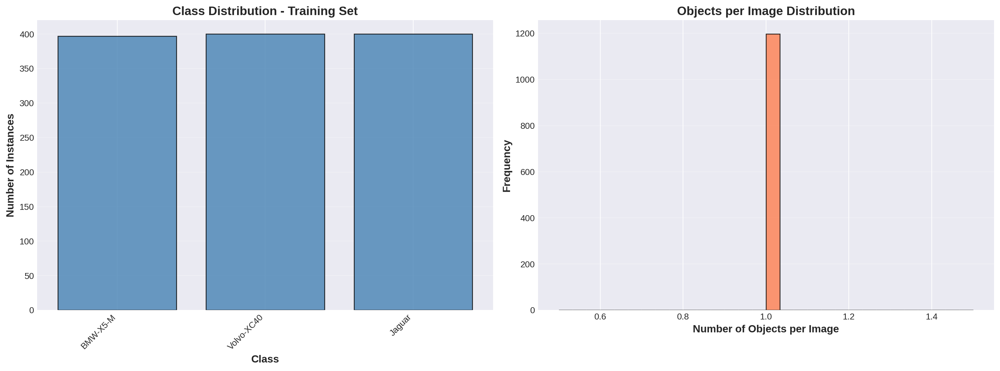


 Saved: results/eda_class_distribution.png


In [9]:
# Visualize class distribution
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Training set class distribution
classes = [data_config['names'][i] for i in sorted(train_stats['class_counts'].keys())]
counts = [train_stats['class_counts'][i] for i in sorted(train_stats['class_counts'].keys())]

axes[0].bar(range(len(classes)), counts, color='steelblue', alpha=0.8, edgecolor='black')
axes[0].set_xlabel('Class', fontsize=12, fontweight='bold')
axes[0].set_ylabel('Number of Instances', fontsize=12, fontweight='bold')
axes[0].set_title('Class Distribution - Training Set', fontsize=14, fontweight='bold')
axes[0].set_xticks(range(len(classes)))
axes[0].set_xticklabels(classes, rotation=45, ha='right')
axes[0].grid(axis='y', alpha=0.3)

# Objects per image distribution
axes[1].hist(train_stats['bbox_counts'], bins=30, color='coral', alpha=0.8, edgecolor='black')
axes[1].set_xlabel('Number of Objects per Image', fontsize=12, fontweight='bold')
axes[1].set_ylabel('Frequency', fontsize=12, fontweight='bold')
axes[1].set_title('Objects per Image Distribution', fontsize=14, fontweight='bold')
axes[1].grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.savefig(f'{RESULTS_DIR}/eda_class_distribution.png', dpi=300, bbox_inches='tight')
plt.show()

print(f"\n Saved: {RESULTS_DIR}/eda_class_distribution.png")

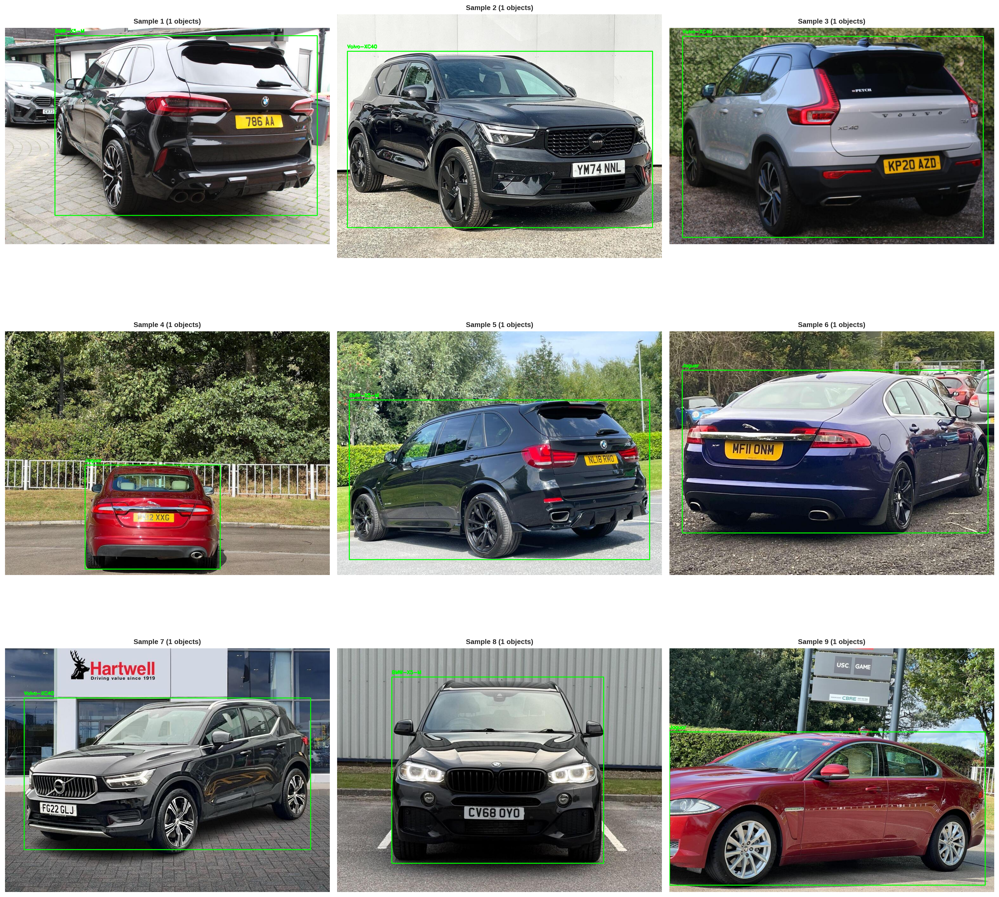


 Saved: results/sample_annotated_images.png


In [10]:
# Visualize sample images with annotations
def visualize_samples(num_samples=9):
    train_images_path = Path(dataset_path) / 'images' / 'train'  # Fixed path
    train_labels_path = Path(dataset_path) / 'labels' / 'train'  # Fixed path
    
    sample_images = np.random.choice(train_stats['images'], 
                                     min(num_samples, len(train_stats['images'])), 
                                     replace=False)
    
    grid_size = int(np.ceil(np.sqrt(num_samples)))
    fig, axes = plt.subplots(grid_size, grid_size, figsize=(20, 20))
    axes = axes.ravel() if num_samples > 1 else [axes]
    
    for idx, img_path in enumerate(sample_images):
        # Read image
        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        h, w = img.shape[:2]
        
        # Read labels
        label_path = train_labels_path / f"{img_path.stem}.txt"
        num_boxes = 0
        
        if label_path.exists():
            with open(label_path, 'r') as f:
                for line in f.readlines():
                    parts = line.strip().split()
                    if len(parts) >= 5:
                        class_id = int(parts[0])
                        x_center, y_center, width, height = map(float, parts[1:5])
                        
                        # Convert to pixel coordinates
                        x1 = int((x_center - width/2) * w)
                        y1 = int((y_center - height/2) * h)
                        x2 = int((x_center + width/2) * w)
                        y2 = int((y_center + height/2) * h)
                        
                        # Draw box
                        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
                        
                        # Add label
                        class_name = data_config['names'][class_id]
                        cv2.putText(img, class_name, (x1, y1-10),
                                  cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
                        num_boxes += 1
        
        axes[idx].imshow(img)
        axes[idx].axis('off')
        axes[idx].set_title(f"Sample {idx+1} ({num_boxes} objects)", fontsize=10, fontweight='bold')
    
    # Hide unused subplots
    for idx in range(len(sample_images), len(axes)):
        axes[idx].axis('off')
    
    plt.tight_layout()
    plt.savefig(f'{RESULTS_DIR}/sample_annotated_images.png', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"\n Saved: {RESULTS_DIR}/sample_annotated_images.png")

visualize_samples(9)


## Model Training - YOLOv11

Now we'll train the YOLOv11 model on the playing cards dataset.

In [ ]:
# Training parameters
EPOCHS = 50
IMG_SIZE = 640
BATCH_SIZE = 16
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
## on GPU btw
print(f"Training Configuration:")
print(f"  Epochs: {EPOCHS}")
print(f"  Image Size: {IMG_SIZE}")
print(f"  Batch Size: {BATCH_SIZE}")
print(f"  Device: {DEVICE}")

# Train YOLOv11
print("\n" + "="*80)
print("TRAINING YOLOv11")
print("="*80)

yolov11_start_time = time.time()

# Initialize model
print("\nInitializing YOLOv11 model...")
model_v11 = YOLO('/shared_directory/migrate/DL_Object_detection-main/test/yolo11n.pt') ## You can just mention yolo11n.pt that will download the model from ultralytics hub directly 

# Train
print("\nStarting training...")
results_v11 = model_v11.train(
    data=f'{dataset_path}/data.yaml',
    epochs=EPOCHS,
    imgsz=IMG_SIZE,
    batch=BATCH_SIZE,
    name='yolov11_car_detection',
    project='.',  
    patience=10,
    save=True,
    device=DEVICE,
    optimizer='AdamW',
    lr0=0.01,
    lrf=0.01,
    momentum=0.937,
    weight_decay=0.0005,
    warmup_epochs=3,
    warmup_momentum=0.8,
    box=7.5,
    cls=0.5,
    dfl=1.5,
    plots=True,
    verbose=True,
    workers=2
)

yolov11_training_time = time.time() - yolov11_start_time

print(f"\n" + "="*80)
print(f"YOLOv11 Training completed in {yolov11_training_time:.2f} seconds ({yolov11_training_time/60:.2f} minutes)")
print("="*80)

Training Configuration:
  Epochs: 50
  Image Size: 640
  Batch Size: 16
  Device: cuda

TRAINING YOLOv11

Initializing YOLOv11 model...

Starting training...
New https://pypi.org/project/ultralytics/8.3.232 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.231 🚀 Python-3.12.8 torch-2.9.1+cu128 CUDA:0 (Tesla T4, 14916MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=dataset/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4,

       1/50      2.19G     0.8179      1.839      1.299         25        640: 100% ━━━━━━━━━━━━ 75/75 2.6it/s 29.1s0.2ss
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 1.1it/s 9.3s.1s
                   all        300        300    0.00598    0.00324   0.000879   0.000157

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       2/50      2.44G     0.8511      1.388      1.304         31        640: 100% ━━━━━━━━━━━━ 75/75 6.6it/s 11.4s0.1s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 8.2it/s 1.2s.1s
                   all        300        300      0.014      0.131     0.0109     0.0025

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       3/50      2.44G     0.8586      1.347      1.302         33        640: 100% ━━━━━━━━━━━━ 75/75 6.8it/s 11.1s0.1s
                 Class     Images  Insta

In [13]:
# Validate YOLOv11
print("\nValidating YOLOv11 model...")
val_results_v11 = model_v11.val(data='dataset/data.yaml', workers=0 )

print("\n" + "="*80)
print("YOLOv11 VALIDATION METRICS")
print("="*80)
print(f"mAP@0.5      : {val_results_v11.box.map50:.4f}")
print(f"mAP@0.5:0.95 : {val_results_v11.box.map:.4f}")
print(f"Precision    : {val_results_v11.box.mp:.4f}")
print(f"Recall       : {val_results_v11.box.mr:.4f}")
print("="*80)


Validating YOLOv11 model...
Ultralytics 8.3.231 🚀 Python-3.12.8 torch-2.9.1+cu128 CUDA:0 (Tesla T4, 14916MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2919.0±700.7 MB/s, size: 107.8 KB)
val: Scanning /shared_directory/migrate/DL_Object_detection-main/test/dataset/labels/val.cache... 300 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 300/300 817.6Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 19/19 3.7it/s 5.2s0.3s
                   all        300        300      0.989      0.982      0.992      0.987
              BMW-X5-M        100        100          1      0.986      0.992      0.987
            Volvo-XC40         97         97      0.999      0.969      0.994      0.992
                Jaguar        103        103      0.969       0.99      0.991       0.98
Speed: 0.3ms preprocess, 3.9ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to /shared_directory/migrate/runs/detect/va


## Model Training - YOLOv12

Now we'll train the YOLOv12 model on the playing cards dataset.

In [14]:
# Train YOLOv12
print("\n" + "="*80)
print("TRAINING YOLOv12")
print("="*80)

yolov12_start_time = time.time()

# Initialize model
print("\nInitializing YOLOv12 model...")
model_v12 = YOLO('/shared_directory/migrate/DL_Object_detection-main/test/yolo12n.pt')

# Train
print("\nStarting training...")
results_v12 = model_v12.train(
    data=f'{dataset_path}/data.yaml',
    epochs=EPOCHS,
    imgsz=IMG_SIZE,
    batch=BATCH_SIZE,
    name='yolov12_car_detection',
    project='.',  # Save in current directory
    patience=10,
    save=True,
    device=DEVICE,
    optimizer='AdamW',
    lr0=0.01,
    lrf=0.01,
    momentum=0.937,
    weight_decay=0.0005,
    warmup_epochs=3,
    warmup_momentum=0.8,
    box=7.5,
    cls=0.5,
    dfl=1.5,
    plots=True,workers=0,
    verbose=True
)

yolov12_training_time = time.time() - yolov12_start_time

print(f"\n" + "="*80)
print(f"YOLOv12 Training completed in {yolov12_training_time:.2f} seconds ({yolov12_training_time/60:.2f} minutes)")
print("="*80)


TRAINING YOLOv12

Initializing YOLOv12 model...

Starting training...
New https://pypi.org/project/ultralytics/8.3.232 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.231 🚀 Python-3.12.8 torch-2.9.1+cu128 CUDA:0 (Tesla T4, 14916MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=dataset/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/shared_directory/migrate/DL_Object_detectio

In [15]:
# Validate YOLOv12
print("\nValidating YOLOv12 model...")
val_results_v12 = model_v12.val(data='dataset/data.yaml', workers=0 )

print("\n" + "="*80)
print("YOLOv12 VALIDATION METRICS")
print("="*80)
print(f"mAP@0.5      : {val_results_v12.box.map50:.4f}")
print(f"mAP@0.5:0.95 : {val_results_v12.box.map:.4f}")
print(f"Precision    : {val_results_v12.box.mp:.4f}")
print(f"Recall       : {val_results_v12.box.mr:.4f}")
print("="*80)


Validating YOLOv12 model...
Ultralytics 8.3.231 🚀 Python-3.12.8 torch-2.9.1+cu128 CUDA:0 (Tesla T4, 14916MiB)
YOLOv12n summary (fused): 159 layers, 2,557,313 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2729.5±810.9 MB/s, size: 130.1 KB)
val: Scanning /shared_directory/migrate/DL_Object_detection-main/test/dataset/labels/val.cache... 300 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 300/300 894.3Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 19/19 3.5it/s 5.5s0.3s
                   all        300        300      0.984       0.99      0.991      0.985
              BMW-X5-M        100        100      0.997       0.99      0.993      0.987
            Volvo-XC40         97         97      0.986      0.979      0.989      0.983
                Jaguar        103        103       0.97          1      0.992      0.984
Speed: 0.3ms preprocess, 4.4ms inference, 0.0ms loss, 0

## Performance Comparison

Let's compare the performance of both models.

In [16]:
# Create comparison dataframe
comparison_df = pd.DataFrame({
    'Model': ['YOLOv11', 'YOLOv12'],
    'mAP@0.5': [val_results_v11.box.map50, val_results_v12.box.map50],
    'mAP@0.5:0.95': [val_results_v11.box.map, val_results_v12.box.map],
    'Precision': [val_results_v11.box.mp, val_results_v12.box.mp],
    'Recall': [val_results_v11.box.mr, val_results_v12.box.mr],
    'Training Time (min)': [yolov11_training_time/60, yolov12_training_time/60]
})

# Calculate F1 score
comparison_df['F1 Score'] = 2 * (comparison_df['Precision'] * comparison_df['Recall']) / \
                            (comparison_df['Precision'] + comparison_df['Recall'])

print("\n" + "="*80)
print("PERFORMANCE COMPARISON: YOLOv11 vs YOLOv12")
print("="*80)
print(comparison_df.to_string(index=False))
print("="*80)

# Save comparison
comparison_df.to_csv(f'{RESULTS_DIR}/model_comparison_local.csv', index=False)
print(f"\n Saved: {RESULTS_DIR}/model_comparison_local.csv")


PERFORMANCE COMPARISON: YOLOv11 vs YOLOv12
  Model  mAP@0.5  mAP@0.5:0.95  Precision   Recall  Training Time (min)  F1 Score
YOLOv11 0.992344      0.986640   0.989181 0.981765            11.178698  0.985459
YOLOv12 0.991264      0.984709   0.984444 0.989794            36.672683  0.987112

 Saved: results/model_comparison_local.csv


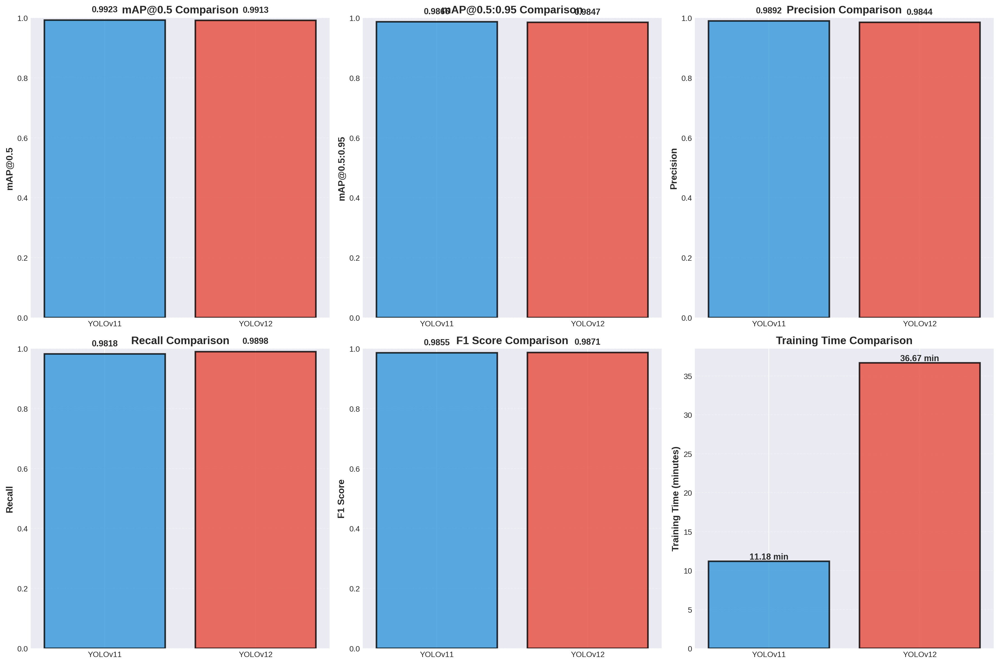


 Saved: results/performance_comparison_local.png


In [17]:
# Visualize performance comparison
fig, axes = plt.subplots(2, 3, figsize=(18, 12))
axes = axes.ravel()

metrics = ['mAP@0.5', 'mAP@0.5:0.95', 'Precision', 'Recall', 'F1 Score']
colors = ['#3498db', '#e74c3c']

for idx, metric in enumerate(metrics):
    ax = axes[idx]
    values = comparison_df[metric].values
    bars = ax.bar(comparison_df['Model'], values, color=colors, alpha=0.8, 
                  edgecolor='black', linewidth=2)
    
    ax.set_ylabel(metric, fontsize=12, fontweight='bold')
    ax.set_title(f'{metric} Comparison', fontsize=14, fontweight='bold')
    ax.set_ylim([0, 1.0])
    ax.grid(axis='y', alpha=0.3, linestyle='--')
    
    # Add value labels
    for bar in bars:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2., height + 0.02,
               f'{height:.4f}',
               ha='center', va='bottom', fontsize=11, fontweight='bold')

# Training time comparison
ax = axes[5]
training_times = comparison_df['Training Time (min)'].values
bars = ax.bar(comparison_df['Model'], training_times, color=colors, alpha=0.8,
             edgecolor='black', linewidth=2)

ax.set_ylabel('Training Time (minutes)', fontsize=12, fontweight='bold')
ax.set_title('Training Time Comparison', fontsize=14, fontweight='bold')
ax.grid(axis='y', alpha=0.3, linestyle='--')

for bar in bars:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2., height,
           f'{height:.2f} min',
           ha='center', va='bottom', fontsize=11, fontweight='bold')

plt.tight_layout()
plt.savefig(f'{RESULTS_DIR}/performance_comparison_local.png', dpi=300, bbox_inches='tight')
plt.show()

print(f"\n Saved: {RESULTS_DIR}/performance_comparison_local.png")

## Model Evaluation

Display confusion matrices and other evaluation metrics.

Found YOLOv11 confusion matrix: yolov11_car_detection/confusion_matrix.png
Found YOLOv12 confusion matrix: yolov12_car_detection/confusion_matrix.png


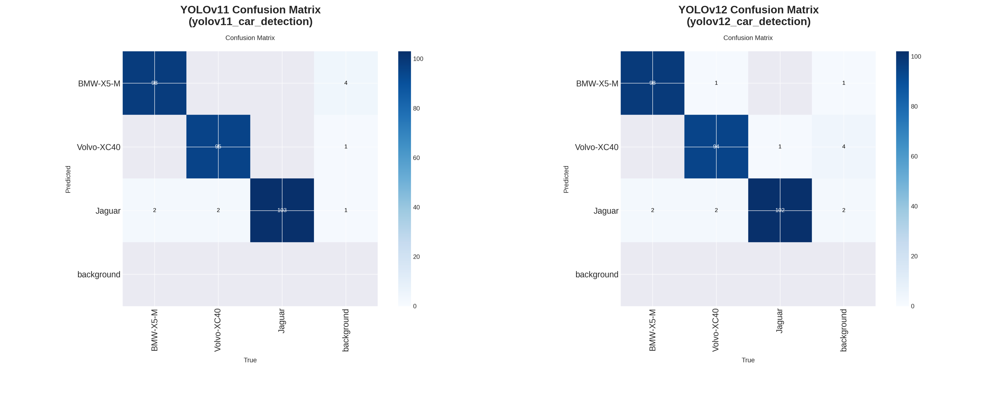


 Saved: results/confusion_matrices_comparison.png


In [18]:
# Display confusion matrices
import glob

fig, axes = plt.subplots(1, 2, figsize=(18, 8))

# YOLOv11 confusion matrix - Look in current directory
v11_runs = sorted(glob.glob('yolov11_*'), key=os.path.getmtime, reverse=True)
v11_cm_path = None
if v11_runs:
    for run_dir in v11_runs:
        cm_path = os.path.join(run_dir, 'confusion_matrix.png')
        if os.path.exists(cm_path):
            v11_cm_path = cm_path
            break

if v11_cm_path and os.path.exists(v11_cm_path):
    img_v11_cm = plt.imread(v11_cm_path)
    axes[0].imshow(img_v11_cm)
    axes[0].set_title(f'YOLOv11 Confusion Matrix\n({os.path.basename(os.path.dirname(v11_cm_path))})', 
                     fontsize=14, fontweight='bold')
    axes[0].axis('off')
    print(f"Found YOLOv11 confusion matrix: {v11_cm_path}")
else:
    axes[0].text(0.5, 0.5, 'Confusion matrix not found\nRun training first', 
                ha='center', va='center', transform=axes[0].transAxes, fontsize=12)
    axes[0].set_title('YOLOv11 Confusion Matrix', fontsize=14, fontweight='bold')
    print("YOLOv11 confusion matrix not found")

# YOLOv12 confusion matrix - Look in current directory
v12_runs = sorted(glob.glob('yolov12_*'), key=os.path.getmtime, reverse=True)
v12_cm_path = None
if v12_runs:
    for run_dir in v12_runs:
        cm_path = os.path.join(run_dir, 'confusion_matrix.png')
        if os.path.exists(cm_path):
            v12_cm_path = cm_path
            break

if v12_cm_path and os.path.exists(v12_cm_path):
    img_v12_cm = plt.imread(v12_cm_path)
    axes[1].imshow(img_v12_cm)
    axes[1].set_title(f'YOLOv12 Confusion Matrix\n({os.path.basename(os.path.dirname(v12_cm_path))})', 
                     fontsize=14, fontweight='bold')
    axes[1].axis('off')
    print(f"Found YOLOv12 confusion matrix: {v12_cm_path}")
else:
    axes[1].text(0.5, 0.5, 'Confusion matrix not found\nRun training first', 
                ha='center', va='center', transform=axes[1].transAxes, fontsize=12)
    axes[1].set_title('YOLOv12 Confusion Matrix', fontsize=14, fontweight='bold')
    print("YOLOv12 confusion matrix not found")

plt.tight_layout()
plt.savefig(f'{RESULTS_DIR}/confusion_matrices_comparison.png', dpi=300, bbox_inches='tight')
plt.show()

print(f"\n Saved: {RESULTS_DIR}/confusion_matrices_comparison.png")

## Inference and Visualization

Run inference on sample images and visualize predictions.


Processing: Jaguar_EP-4_8.jpg


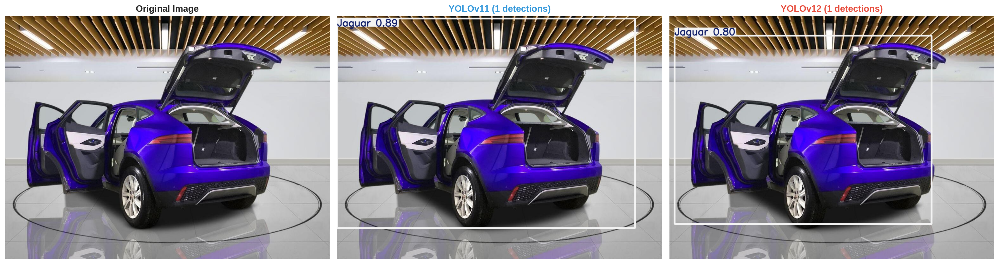

 Saved: results/inference_comparison_1.png

Processing: Volvo-XC40_volvo-7.jpg


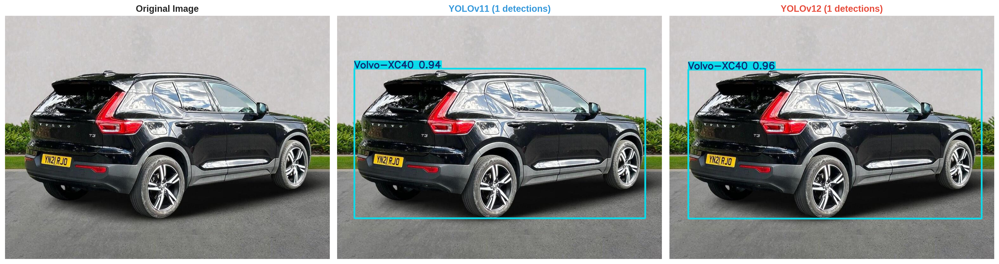

 Saved: results/inference_comparison_2.png

Processing: BMW-X5-M_X5-M-13.jpg


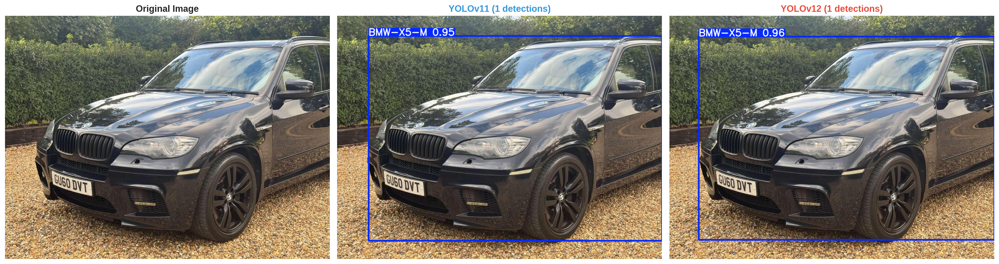

 Saved: results/inference_comparison_3.png


In [19]:
# Run inference on sample validation images
val_images_path = Path(dataset_path) / 'images' / 'val'  # Fixed path
val_images = list(val_images_path.glob('*.jpg')) + list(val_images_path.glob('*.png'))
sample_test_images = np.random.choice(val_images, min(3, len(val_images)), replace=False)

for idx, img_path in enumerate(sample_test_images):
    print(f"\nProcessing: {img_path.name}")
    
    # Get predictions
    results_v11_inf = model_v11.predict(str(img_path), conf=0.25, save=False, verbose=False)
    results_v12_inf = model_v12.predict(str(img_path), conf=0.25, save=False, verbose=False)
    
    # Visualize
    fig, axes = plt.subplots(1, 3, figsize=(20, 7))
    
    # Original
    original_img = cv2.imread(str(img_path))
    original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
    axes[0].imshow(original_img)
    axes[0].set_title('Original Image', fontsize=13, fontweight='bold')
    axes[0].axis('off')
    
    # YOLOv11
    img_v11 = results_v11_inf[0].plot()
    img_v11 = cv2.cvtColor(img_v11, cv2.COLOR_BGR2RGB)
    axes[1].imshow(img_v11)
    axes[1].set_title(f'YOLOv11 ({len(results_v11_inf[0].boxes)} detections)',
                     fontsize=13, fontweight='bold', color='#3498db')
    axes[1].axis('off')
    
    # YOLOv12
    img_v12 = results_v12_inf[0].plot()
    img_v12 = cv2.cvtColor(img_v12, cv2.COLOR_BGR2RGB)
    axes[2].imshow(img_v12)
    axes[2].set_title(f'YOLOv12 ({len(results_v12_inf[0].boxes)} detections)',
                     fontsize=13, fontweight='bold', color='#e74c3c')
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.savefig(f'{RESULTS_DIR}/inference_comparison_{idx+1}.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    print(f" Saved: {RESULTS_DIR}/inference_comparison_{idx+1}.png")

## Cloud vs Local Comparison

Document the differences between cloud and local execution.

In [20]:
# Create environment comparison
env_info = f"""
{'='*80}
LOCAL LINUX ENVIRONMENT INFORMATION
{'='*80}

Platform: {platform.system()} {platform.release()}
Machine: {platform.machine()}
Python Version: {sys.version.split()[0]}

GPU Information:
  CUDA Available: {torch.cuda.is_available()}
"""

if torch.cuda.is_available():
    env_info += f"""  GPU Device: {torch.cuda.get_device_name(0)}
  CUDA Version: {torch.version.cuda}
  cuDNN Version: {torch.backends.cudnn.version()}
"""

env_info += f"""
Key Library Versions:
  PyTorch: {torch.__version__}
  NumPy: {np.__version__}
  OpenCV: {cv2.__version__}
  Pandas: {pd.__version__}
  Matplotlib: {plt.matplotlib.__version__}
  
Training Performance:
  YOLOv11 Training Time: {yolov11_training_time/60:.2f} minutes
  YOLOv12 Training Time: {yolov12_training_time/60:.2f} minutes
  
Model Performance:
  YOLOv11 mAP@0.5: {val_results_v11.box.map50:.4f}
  YOLOv12 mAP@0.5: {val_results_v12.box.map50:.4f}
  
{'='*80}
"""

print(env_info)

# Save environment info
with open(f'{RESULTS_DIR}/local_environment_info.txt', 'w') as f:
    f.write(env_info)

print(f"\n Saved: {RESULTS_DIR}/local_environment_info.txt")


LOCAL LINUX ENVIRONMENT INFORMATION

Platform: Linux 6.8.0-1019-aws
Machine: x86_64
Python Version: 3.12.8

GPU Information:
  CUDA Available: True
  GPU Device: Tesla T4
  CUDA Version: 12.8
  cuDNN Version: 91002

Key Library Versions:
  PyTorch: 2.9.1+cu128
  NumPy: 2.2.6
  OpenCV: 4.12.0
  Pandas: 2.3.3
  Matplotlib: 3.10.7

Training Performance:
  YOLOv11 Training Time: 11.18 minutes
  YOLOv12 Training Time: 36.67 minutes

Model Performance:
  YOLOv11 mAP@0.5: 0.9923
  YOLOv12 mAP@0.5: 0.9913



 Saved: results/local_environment_info.txt


## Summary and Conclusion

Generate comprehensive summary report.

In [21]:
# Calculate total execution time
total_execution_time = time.time() - execution_start_time

# Create comprehensive summary
summary = f"""
{'='*80}
PLAYING CARDS DETECTION - COMPREHENSIVE SUMMARY (LOCAL LINUX)
{'='*80}

DATASET INFORMATION:
  Name: Playing Cards Detection (Roboflow)
  Number of Classes: {data_config['nc']}
  Classes: {', '.join(data_config['names'].values())}
  Training Images: {len(train_stats['images'])}
  Validation Images: {len(val_stats['images'])}

COMPUTING ENVIRONMENT:
  Platform: Local Linux Machine
  Device: {'GPU - ' + torch.cuda.get_device_name(0) if torch.cuda.is_available() else 'CPU'}
  PyTorch Version: {torch.__version__}
  CUDA Available: {torch.cuda.is_available()}
{('  CUDA Version: ' + str(torch.version.cuda)) if torch.cuda.is_available() else ''}

YOLOV11 PERFORMANCE:
  mAP@0.5      : {val_results_v11.box.map50:.4f}
  mAP@0.5:0.95 : {val_results_v11.box.map:.4f}
  Precision    : {val_results_v11.box.mp:.4f}
  Recall       : {val_results_v11.box.mr:.4f}
  Training Time: {yolov11_training_time/60:.2f} minutes

YOLOV12 PERFORMANCE:
  mAP@0.5      : {val_results_v12.box.map50:.4f}
  mAP@0.5:0.95 : {val_results_v12.box.map:.4f}
  Precision    : {val_results_v12.box.mp:.4f}
  Recall       : {val_results_v12.box.mr:.4f}
  Training Time: {yolov12_training_time/60:.2f} minutes

PERFORMANCE DIFFERENCE:
  mAP@0.5 Difference: {(val_results_v12.box.map50 - val_results_v11.box.map50):+.4f} ({'higher' if val_results_v12.box.map50 > val_results_v11.box.map50 else 'lower'} for YOLOv12)
  mAP@0.5:0.95 Difference: {(val_results_v12.box.map - val_results_v11.box.map):+.4f} ({'higher' if val_results_v12.box.map > val_results_v11.box.map else 'lower'} for YOLOv12)
  Training Time Difference: {abs(yolov12_training_time - yolov11_training_time)/60:.2f} minutes ({'faster' if yolov12_training_time < yolov11_training_time else 'slower'} for YOLOv12)

TOTAL EXECUTION TIME: {total_execution_time/60:.2f} minutes
DATE: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}
{'='*80}
"""

print(summary)

# Save summary
with open(f'{RESULTS_DIR}/local_execution_summary.txt', 'w') as f:
    f.write(summary)

print(f"\n Saved: {RESULTS_DIR}/local_execution_summary.txt")


PLAYING CARDS DETECTION - COMPREHENSIVE SUMMARY (LOCAL LINUX)

DATASET INFORMATION:
  Name: Playing Cards Detection (Roboflow)
  Number of Classes: 3
  Classes: BMW-X5-M, Volvo-XC40, Jaguar
  Training Images: 1197
  Validation Images: 300

COMPUTING ENVIRONMENT:
  Platform: Local Linux Machine
  Device: GPU - Tesla T4
  PyTorch Version: 2.9.1+cu128
  CUDA Available: True
  CUDA Version: 12.8

YOLOV11 PERFORMANCE:
  mAP@0.5      : 0.9923
  mAP@0.5:0.95 : 0.9866
  Precision    : 0.9892
  Recall       : 0.9818
  Training Time: 11.18 minutes

YOLOV12 PERFORMANCE:
  mAP@0.5      : 0.9913
  mAP@0.5:0.95 : 0.9847
  Precision    : 0.9844
  Recall       : 0.9898
  Training Time: 36.67 minutes

PERFORMANCE DIFFERENCE:
  mAP@0.5 Difference: -0.0011 (lower for YOLOv12)
  mAP@0.5:0.95 Difference: -0.0019 (lower for YOLOv12)
  Training Time Difference: 25.49 minutes (slower for YOLOv12)

TOTAL EXECUTION TIME: 51.70 minutes
DATE: 2025-11-25 13:54:42


 Saved: results/local_execution_summary.txt


In [22]:
# Save trained models
print("\n" + "="*80)
print("SAVING TRAINED MODELS")
print("="*80)

models_dir = f'{RESULTS_DIR}/models'
os.makedirs(models_dir, exist_ok=True)

# Copy best models from current directory
v11_model_path = 'yolov11_car_detection/weights/best.pt'
v12_model_path = 'yolov12_car_detection/weights/best.pt'

if os.path.exists(v11_model_path):
    shutil.copy(v11_model_path, f'{models_dir}/yolov11_best.pt')
    print("  yolov11_best.pt")
else:
    print("  YOLOv11 model not found")

if os.path.exists(v12_model_path):
    shutil.copy(v12_model_path, f'{models_dir}/yolov12_best.pt')
    print("  yolov12_best.pt")
else:
    print("  YOLOv12 model not found")

print(f"\nModels saved to: {models_dir}")
print("="*80)


SAVING TRAINED MODELS
  yolov11_best.pt
  yolov12_best.pt

Models saved to: results/models


In [ ]:
# Final summary of generated files
print("\n" + "="*80)
print("GENERATED FILES SUMMARY")
print("="*80)
print(f"\nResults Directory: {RESULTS_DIR}/")
print("\nVisualizations:")
print("eda_class_distribution.png")
print("sample_annotated_images.png")
print("performance_comparison_local.png")
print("confusion_matrices_comparison.png")
print("inference_comparison_*.png")
print("\nData Files:")
print("model_comparison_local.csv")
print("local_execution_summary.txt")
print("local_environment_info.txt")
print("\nModels:")
print("models/yolov11_best.pt")
print("models/yolov12_best.pt")
print("\nTraining Outputs (in current directory):")
print("yolov11_car_detection/")
print("yolov12_car_detection/")
print("\n" + "="*80)
print(" ALL TASKS COMPLETED SUCCESSFULLY!")
print("="*80)


GENERATED FILES SUMMARY

Results Directory: results/

Visualizations:
   eda_class_distribution.png
   sample_annotated_images.png
   performance_comparison_local.png
   confusion_matrices_comparison.png
   inference_comparison_*.png

Data Files:
   model_comparison_local.csv
   local_execution_summary.txt
   local_environment_info.txt

Models:
   models/yolov11_best.pt
   models/yolov12_best.pt

Training Outputs (in current directory):
   yolov11_car_detection/
   yolov12_car_detection/

 ALL TASKS COMPLETED SUCCESSFULLY!
